Applications - Part I
- Explain image segmentation
- Perform image segmentation on a given image
- Implement object detection using template matching
- Explain contours and contour detection in images
- Understand how data augmentation artificially increases the training set by creating modified copies
of a dataset using existing data

# Interactive Tutorial: Image Processing and Computer Vision with Python

## Table of Contents
1. [Introduction](#introduction)
2. [Setting Up the Environment](#setup)
3. [Image Segmentation](#image-segmentation)
   - [Theoretical Foundations](#theoretical-foundations)
   - [Thresholding Techniques](#thresholding)
   - [Edge-Based Segmentation](#edge-based)
   - [Region-Based Segmentation](#region-based)
4. [Object Detection](#object-detection)
   - [Template Matching](#template-matching)
   - [Parameter Tuning](#parameter-tuning)
5. [Contour Analysis](#contour-analysis)
   - [Contour Properties](#contour-properties)
   - [Hierarchical Contours](#hierarchical-contours)
6. [Data Augmentation](#data-augmentation)
   - [Transformation Techniques](#transformation-techniques)
   - [Implementation](#augmentation-implementation)
7. [Exercises and Practice Problems](#exercises)

## Introduction to Image Processing and Computer Vision

Welcome to this interactive tutorial on image processing and computer vision! In this notebook, we'll explore fundamental concepts and practical applications, with a focus on image segmentation, object detection, contour analysis, and data augmentation.



In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import random
import os
import math
from IPython.display import Markdown, display

# Set up matplotlib for inline plotting
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)  # Set default figure size

# Part I: Image Segmentation and Object Detection

## 1. Theoretical Foundations of Image Segmentation

Image segmentation is the process of partitioning an image into multiple segments or regions, each with similar characteristics. It's a critical step in image analysis that allows us to:

1. Identify objects and boundaries within images
2. Simplify image representation for easier analysis
3. Extract meaningful information from the visual data

### Mathematical Foundations

Image segmentation can be formalized as partitioning an image $I$ into $n$ non-overlapping regions $R_1, R_2, ..., R_n$ such that:

$\bigcup_{i=1}^{n} R_i = I$ (The union of all regions equals the entire image)

$R_i \cap R_j = \emptyset$ for all $i \neq j$ (Regions do not overlap)

$P(R_i) = \text{True}$ for all $i$ (Each region satisfies a predicate/condition)

$P(R_i \cup R_j) = \text{False}$ for adjacent regions $R_i, R_j$ (Adjacent regions are different)

### Common Segmentation Techniques

1. **Thresholding**: Simplest method, separates pixels based on intensity values
2. **Edge-based**: Identifies boundaries between regions
3. **Region-based**: Groups similar pixels into regions
4. **Clustering-based**: Uses algorithms like K-means to group pixels
5. **Watershed**: Treats image as a topographic surface for segmentation

Let's start exploring these concepts with some practical examples.



Let's start exploring these concepts with some practical examples.

## 2. Basic Image Loading and Manipulation

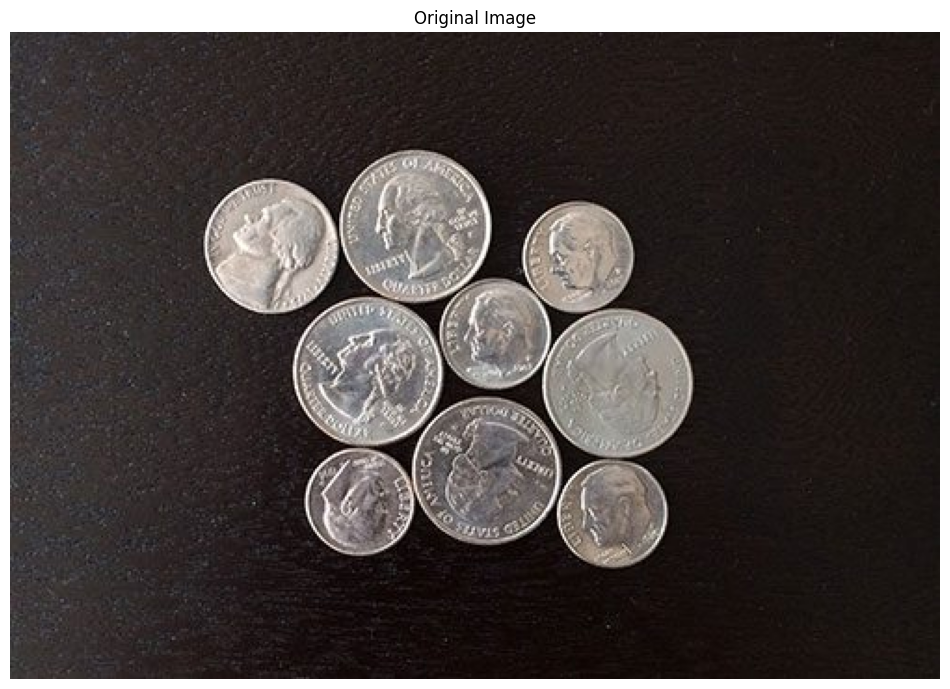

Image dimensions: 500 x 348 pixels
Number of channels: 3
Data type: uint8


In [14]:
# Load the full image where we'll be looking for objects
full_image = cv2.imread('images/coins01.jpg')

# Convert from BGR (OpenCV default) to RGB (for matplotlib)
full_image_rgb = cv2.cvtColor(full_image, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(12, 10))
plt.imshow(full_image_rgb)
plt.title('Original Image')
plt.axis('off')
plt.show()

# Basic image properties
height, width, channels = full_image.shape
print(f"Image dimensions: {width} x {height} pixels")
print(f"Number of channels: {channels}")
print(f"Data type: {full_image.dtype}")

### Intuition Check: Color Channels

Let's examine the individual color channels to better understand how digital images are represented:


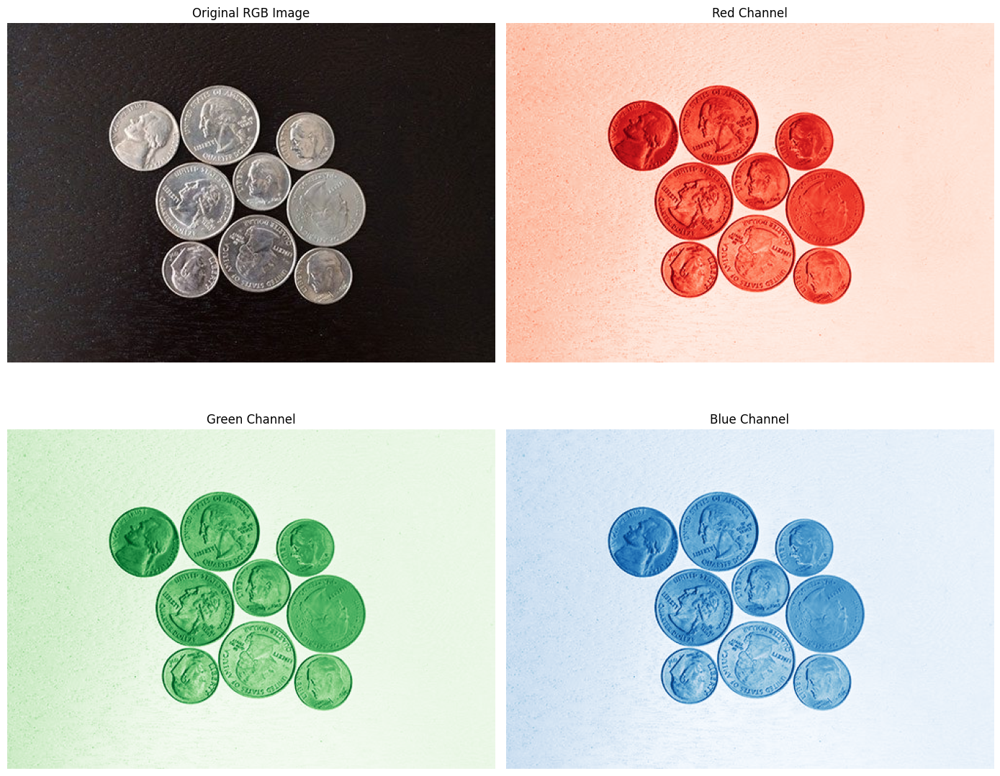

In [15]:

# Separate the color channels
red_channel = full_image_rgb[:, :, 0]
green_channel = full_image_rgb[:, :, 1]
blue_channel = full_image_rgb[:, :, 2]

# Create a figure with 4 subplots
fig, axes = plt.subplots(2, 2, figsize=(14, 12))

# Display the original image and its color channels
axes[0, 0].imshow(full_image_rgb)
axes[0, 0].set_title('Original RGB Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(red_channel, cmap='Reds')
axes[0, 1].set_title('Red Channel')
axes[0, 1].axis('off')

axes[1, 0].imshow(green_channel, cmap='Greens')
axes[1, 0].set_title('Green Channel')
axes[1, 0].axis('off')

axes[1, 1].imshow(blue_channel, cmap='Blues')
axes[1, 1].set_title('Blue Channel')
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

## 3. Image Thresholding for Segmentation

Thresholding is one of the simplest yet effective segmentation techniques. It works by converting a grayscale image into a binary image, where pixels are categorized as either foreground or background based on their intensity values.

### Mathematical Framework

For an input grayscale image $f(x,y)$ and a threshold value $T$, the binary output image $g(x,y)$ is defined as:

$$g(x,y) = \begin{cases}
1 & \text{if } f(x,y) > T \\
0 & \text{otherwise}
\end{cases}$$

Let's implement simple thresholding:

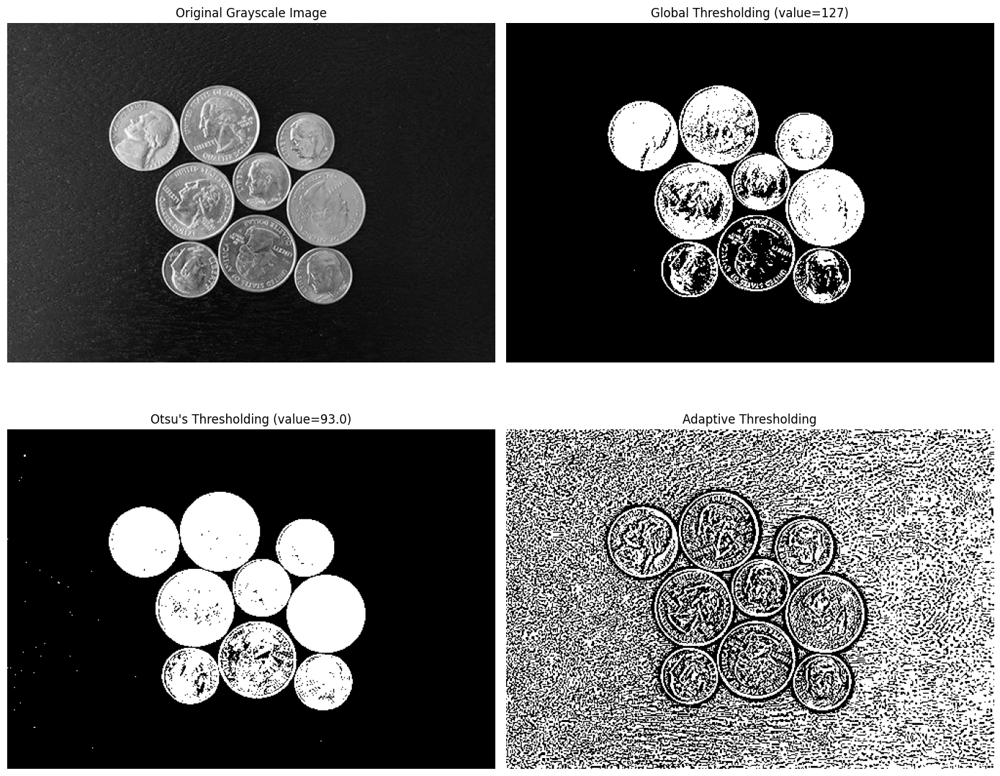

Otsu's automatically determined threshold value: 93.0


In [16]:
# Convert to grayscale
gray_image = cv2.cvtColor(full_image, cv2.COLOR_BGR2GRAY)

# Apply global thresholding
ret, thresh_basic = cv2.threshold(gray_image, 127, 255, cv2.THRESH_BINARY)

# Apply Otsu's thresholding (automatically determines optimal threshold value)
ret_otsu, thresh_otsu = cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Apply adaptive thresholding
thresh_adaptive = cv2.adaptiveThreshold(gray_image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)

# Display results
fig, axes = plt.subplots(2, 2, figsize=(14, 12))

axes[0, 0].imshow(gray_image, cmap='gray')
axes[0, 0].set_title('Original Grayscale Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(thresh_basic, cmap='gray')
axes[0, 1].set_title(f'Global Thresholding (value=127)')
axes[0, 1].axis('off')

axes[1, 0].imshow(thresh_otsu, cmap='gray')
axes[1, 0].set_title(f'Otsu\'s Thresholding (value={ret_otsu})')
axes[1, 0].axis('off')

axes[1, 1].imshow(thresh_adaptive, cmap='gray')
axes[1, 1].set_title('Adaptive Thresholding')
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

print("Otsu's automatically determined threshold value:", ret_otsu)

### Mathematical Foundation

Otsu's method finds the threshold $t$ that maximizes the between-class variance:

$\sigma_B^2(t) = \omega_0(t)\omega_1(t)[\mu_0(t) - \mu_1(t)]^2$

Where:
- $\omega_0(t)$ is the weight of the background class (proportion of pixels)
- $\omega_1(t)$ is the weight of the foreground class
- $\mu_0(t)$ is the mean of the background class
- $\mu_1(t)$ is the mean of the foreground class

### Intuition Check 

Look at the thresholded image. What do you notice about the coins?
- They are touching in many places
- Simple thresholding alone isn't enough to separate them
- We need more sophisticated techniques to identify individual coins



### Common Pitfalls with Thresholding

> **Common Pitfall**: Global thresholding often fails with uneven lighting conditions. What works well for one part of the image may completely fail in another area with different illumination. Always consider using adaptive methods for real-world images.

1. **Single Global Threshold Limitations**: A single threshold value may not work well for images with uneven lighting or varying contrast.

2. **Noise Sensitivity**: Simple thresholding can be highly sensitive to noise, resulting in spurious segments.

3. **Loss of Information**: Thresholding reduces a grayscale image to binary, losing intermediate intensity information.

4. **Context Ignorance**: Thresholding doesn't consider spatial relationships between pixels.

### When to Use Which Thresholding Method:

| Method | Best Use Cases | Limitations | Computational Cost |
|--------|---------------|-------------|-------------------|
| **Global Thresholding** | Images with bimodal histograms and uniform lighting | Fails with varying illumination | Low |
| **Otsu's Method** | When histogram has two distinct peaks | Suboptimal for multimodal distributions | Medium |
| **Adaptive Thresholding** | Images with varying illumination | Parameter tuning can be complex | High |



## 4. Edge-Based Segmentation

Edge detection identifies boundaries between regions by finding sharp changes in intensity. These edges often correspond to important features like object boundaries.

### Mathematical Basis of Edge Detection

Edge detection is based on calculating image gradients. For a 2D image function $f(x,y)$, the gradient vector at each pixel is:

$$\nabla f = \begin{bmatrix} \frac{\partial f}{\partial x} \\ \frac{\partial f}{\partial y} \end{bmatrix}$$

The magnitude of this gradient gives the edge strength:

$$|\nabla f| = \sqrt{\left(\frac{\partial f}{\partial x}\right)^2 + \left(\frac{\partial f}{\partial y}\right)^2}$$

Let's implement edge detection using different methods:

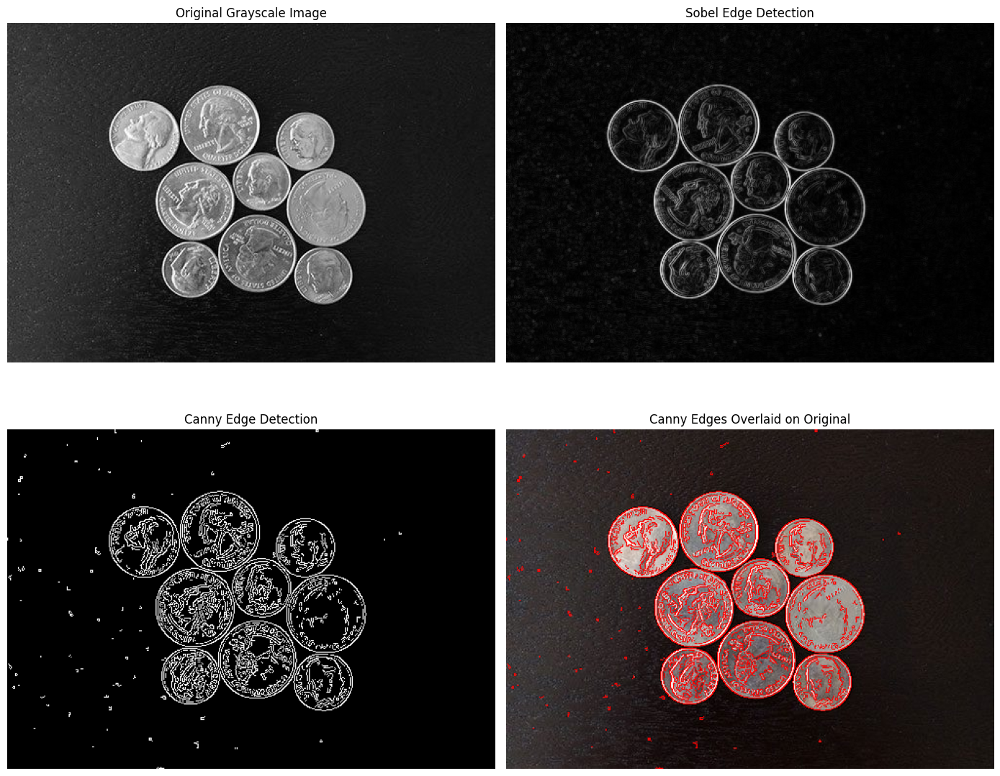

In [17]:
# Apply various edge detection methods
# Sobel operators
sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
sobel_combined = cv2.magnitude(sobelx, sobely)

# Normalize to 0-255 for visualization
sobel_combined = cv2.normalize(sobel_combined, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

# Canny edge detector
canny_edges = cv2.Canny(gray_image, 100, 200)

# Display results
fig, axes = plt.subplots(2, 2, figsize=(14, 12))

axes[0, 0].imshow(gray_image, cmap='gray')
axes[0, 0].set_title('Original Grayscale Image')
axes[0, 0].axis('off')

axes[0, 1].imshow(sobel_combined, cmap='gray')
axes[0, 1].set_title('Sobel Edge Detection')
axes[0, 1].axis('off')

axes[1, 0].imshow(canny_edges, cmap='gray')
axes[1, 0].set_title('Canny Edge Detection')
axes[1, 0].axis('off')

# Create a color overlay of Canny edges on original image
overlay_image = full_image_rgb.copy()
overlay_image[canny_edges > 0] = [255, 0, 0]  # Highlight edges in red

axes[1, 1].imshow(overlay_image)
axes[1, 1].set_title('Canny Edges Overlaid on Original')
axes[1, 1].axis('off')

plt.tight_layout()
plt.show()

### The Canny Edge Detection Algorithm

The Canny edge detector follows multiple steps:
1. Noise reduction using Gaussian filter
2. Gradient calculation using Sobel operators
3. Non-maximum suppression to thin edges
4. Hysteresis thresholding with two thresholds to connect edges

### Practical Exercise: Edge Detection Parameter Tuning

Let's explore how different parameters affect Canny edge detection:

Weak edges (low thresholds):


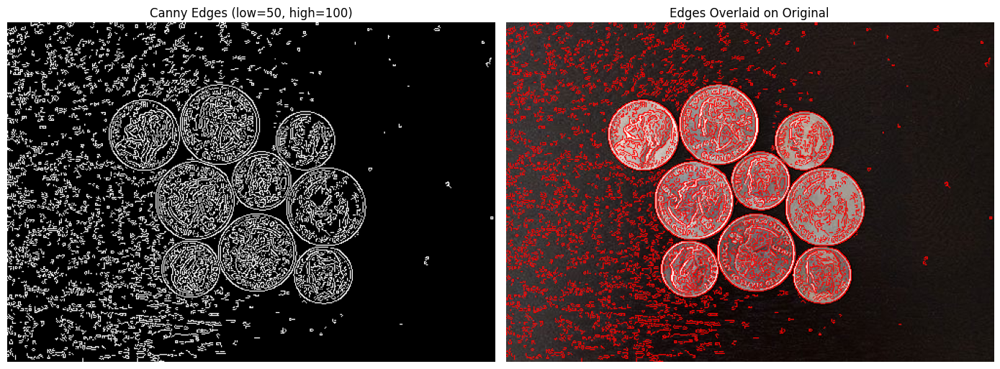

Balanced edges:


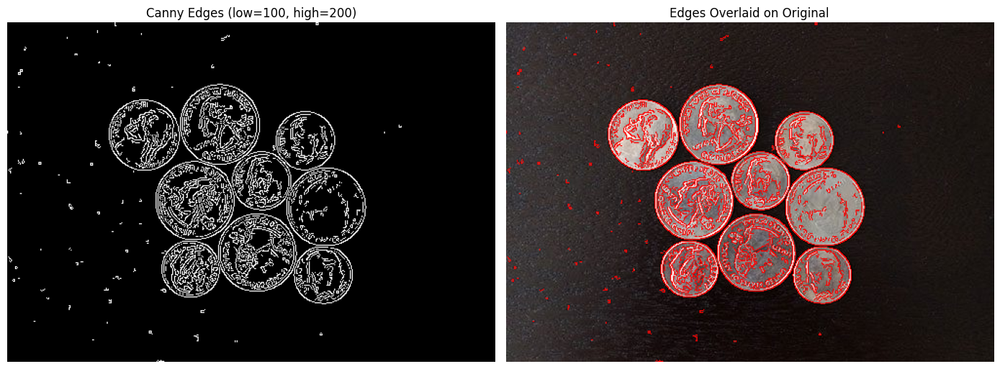

Strong edges (high thresholds):


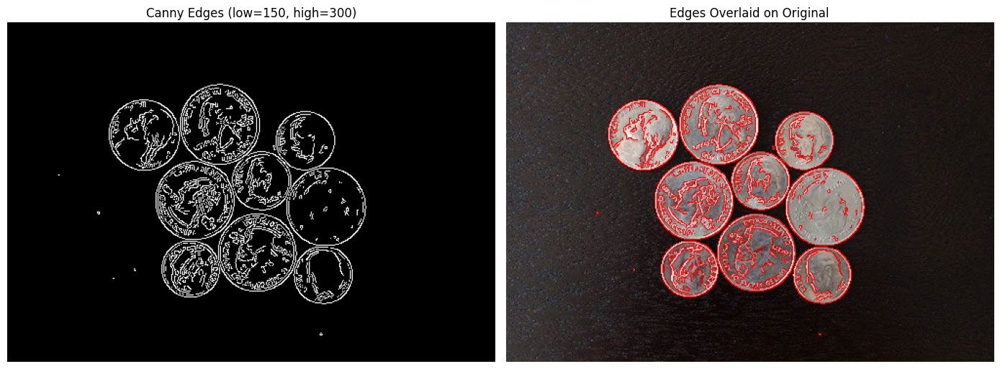

In [18]:
def display_canny_edges(low_threshold, high_threshold):
    """Display Canny edge detection results with given thresholds"""
    edges = cv2.Canny(gray_image, low_threshold, high_threshold)
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 7))
    
    ax1.imshow(edges, cmap='gray')
    ax1.set_title(f'Canny Edges (low={low_threshold}, high={high_threshold})')
    ax1.axis('off')
    
    # Overlay edges on original image
    overlay = full_image_rgb.copy()
    overlay[edges > 0] = [255, 0, 0]  # Red edges
    
    ax2.imshow(overlay)
    ax2.set_title('Edges Overlaid on Original')
    ax2.axis('off')
    
    plt.tight_layout()
    plt.show()

# Try different threshold combinations
print("Weak edges (low thresholds):")
display_canny_edges(50, 100)

print("Balanced edges:")
display_canny_edges(100, 200)

print("Strong edges (high thresholds):")
display_canny_edges(150, 300)

## 5. Region-Based Segmentation

While edge-based methods focus on boundaries, region-based segmentation methods focus on grouping pixels into coherent regions based on similarity criteria.

### Watershed Algorithm

The watershed algorithm treats the image as a topographic surface where bright areas are peaks and dark areas are valleys. It's particularly useful for separating touching objects.

In [43]:

# Set up the plotting style and figure size for better visualization
plt.rcParams['figure.figsize'] = (12, 9)

# Create a helper function to display images in a more organized way
def display_images(images, titles, cmaps=None, suptitle=None, figsize=(15, 10)):
    """
    Display multiple images in a single figure with titles.
    
    Parameters:
    images -- List of images to display
    titles -- List of titles for each image
    cmaps -- List of colormaps for each image (optional)
    suptitle -- Super title for the entire figure (optional)
    figsize -- Figure size (width, height) in inches
    """
    n = len(images)
    fig, axes = plt.subplots(1, n, figsize=figsize)
    
    if n == 1:
        axes = [axes]
    
    for i, (image, title) in enumerate(zip(images, titles)):
        if cmaps is not None:
            axes[i].imshow(image, cmap=cmaps[i])
        else:
            if len(image.shape) == 2:  # Grayscale
                axes[i].imshow(image, cmap='gray')
            else:  # Color
                axes[i].imshow(cv.cvtColor(image, cv.COLOR_BGR2RGB))
                
        axes[i].set_title(title)
        axes[i].axis('off')
    
    if suptitle:
        plt.suptitle(suptitle, fontsize=16)
    
    plt.tight_layout()
    plt.show()


 Algorithm - Theoretical Foundation

The watershed algorithm is inspired by a geographical concept. Imagine a landscape with valleys and mountains:

- Gray levels in an image represent elevation
- Dark regions (low pixel values) represent valleys
- Bright regions (high pixel values) represent peaks
- Water starts filling from the lowest points (minima)
- When waters from different valleys are about to merge, we build barriers (watersheds)
- These barriers represent the segmentation boundaries

### Intuition Check 
Think about what happens when we view an image as a topographic surface:
- Low intensity values (dark areas) are like valleys or basins
- High intensity values (bright areas) are like mountains or ridges
- The watershed algorithm "floods" this landscape from the bottom up
- When waters from different valleys meet, we place a dam (boundary)

These "dams" will eventually form our segmentation boundaries!

## 2. Loading and Examining the Image

Let's start by loading our test image and examining it:

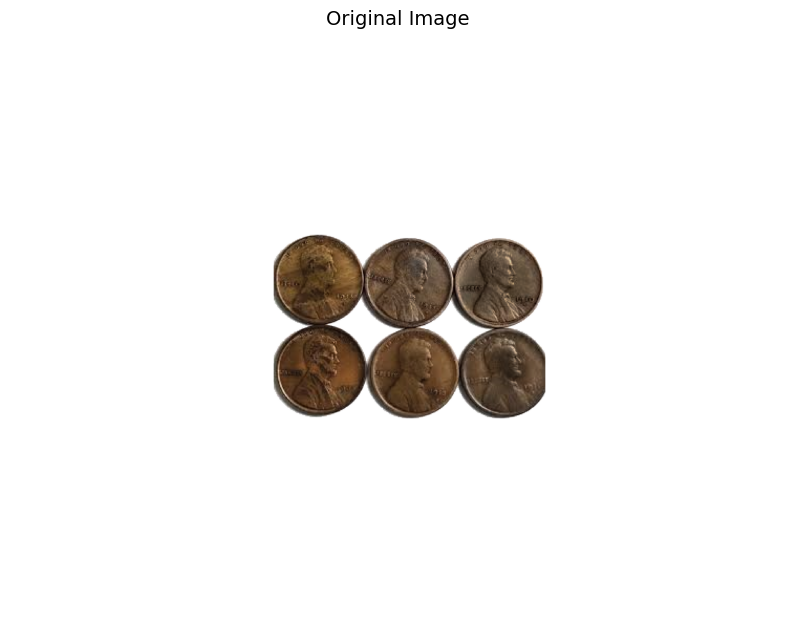

In [44]:
# Load the image
img = cv.imread('images/coins.png')
assert img is not None, "File could not be read, check with os.path.exists()"

# Convert to RGB for display
img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

# Display the original image
plt.figure(figsize=(10, 8))
plt.imshow(img_rgb)
plt.title('Original Image', fontsize=14)
plt.axis('off')
plt.show()

## 3. Image Pre-processing: Grayscale Conversion and Thresholding

First, we need to convert our image to grayscale and apply thresholding:


### 1.1 The Watershed Concept

The watershed algorithm takes its name from geography, where a watershed is the ridge that divides areas drained by different river systems.

> **Intuition Check**: Imagine a grayscale image as a topographic surface:
> - High intensity pixels = peaks and hills
> - Low intensity pixels = valleys
> 
> When rain falls on this landscape, water collects in the valleys (local minima). As the water level rises, water from different valleys begins to merge. We build barriers (watersheds) at these merge points. The final barriers represent the segmentation boundaries.

This geographical metaphor helps us understand how the algorithm identifies boundaries between objects that are touching or overlapping in an image.

### 1.2 Traditional vs. Marker-Based Watershed

**Traditional Watershed**:
- Automatically identifies all local minima as starting points
- Often results in over-segmentation due to noise and texture variations

**Marker-Based Watershed**:
- We explicitly specify which valleys (minima) should be considered
- Provides much better control over the segmentation process
- Requires us to mark known foreground and background regions

> **Common Pitfall**: Applying watershed directly to a grayscale or edge image typically results in severe over-segmentation. Always use the marker-based approach for practical applications.

In [47]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

# Configure matplotlib for inline display
%matplotlib inline

# Helper function to display images side by side
def display_images(images, titles, cmaps=None, figsize=(12, 8)):
    """Display multiple images side by side"""
    n = len(images)
    if cmaps is None:
        cmaps = ['gray'] * n
    
    plt.figure(figsize=figsize)
    for i in range(n):
        plt.subplot(1, n, i+1)
        plt.imshow(images[i], cmap=cmaps[i])
        plt.title(titles[i])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

## 3. Loading and Examining Our Image

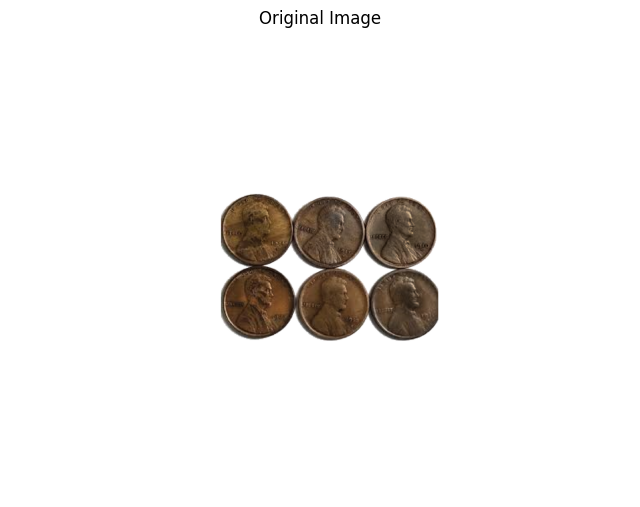

In [48]:
# Load the image
img = cv.imread('images/coins.png')
# Convert to RGB for display (OpenCV loads in BGR)
img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)
# Convert to grayscale for processing
gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

# Display the original image
plt.figure(figsize=(8, 8))
plt.imshow(img_rgb)
plt.title('Original Image')
plt.axis('off')
plt.show()

> **Challenge**: What makes this image challenging for simple segmentation techniques?
>
> <details>
>   <summary>Click to see answer</summary>
>   The coins are touching each other, making it difficult to separate them using simple thresholding. Also, the coins have varied brightness and texture.
> </details>

## 4. Initial Segmentation with Thresholding

First, we'll create a binary image to separate the coins from the background.

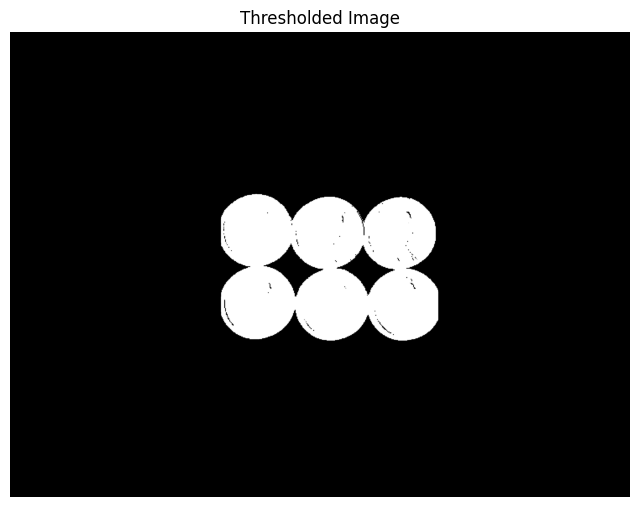

In [49]:
# Apply Otsu's thresholding
ret, thresh = cv.threshold(gray, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)

# Display the thresholded image
plt.figure(figsize=(8, 8))
plt.imshow(thresh, cmap='gray')
plt.title('Thresholded Image')
plt.axis('off')
plt.show()

> **Intuition Check**: Otsu's method automatically determines the optimal threshold value by minimizing the variance within each class (foreground and background). This works well when the image histogram has two distinct peaks.
>
> Notice how the coins are now white against a black background, but they're still touching each other. Simple thresholding alone won't separate the individual coins.

## 5. Noise Removal and Background Identification

Let's clean up our binary image and identify definite background regions.

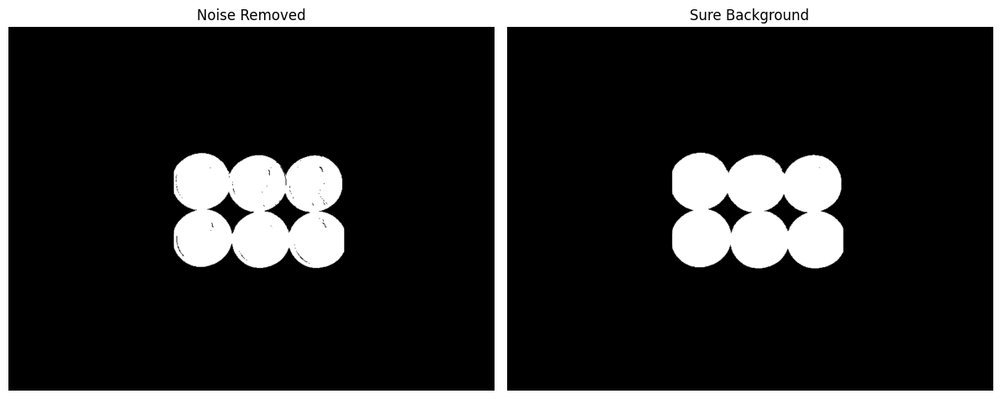

In [50]:
# Define a kernel for morphological operations
kernel = np.ones((3, 3), np.uint8)

# Remove noise with morphological opening
opening = cv.morphologyEx(thresh, cv.MORPH_OPEN, kernel, iterations=2)

# Dilate to find sure background area
sure_bg = cv.dilate(opening, kernel, iterations=3)

# Display the results
display_images([opening, sure_bg], 
               ['Noise Removed', 'Sure Background'], 
               ['gray', 'gray'])

> **(Reminder) Mathematical Foundation**: 
> - **Opening** is erosion followed by dilation. It removes small objects while preserving the shape and size of larger objects.
> - **Dilation** expands the boundaries of objects. After dilation, we're confident that the white areas in `sure_bg` are definitely background.

## 6. Finding Sure Foreground

Now we need to identify areas that are definitely part of the coins (foreground).

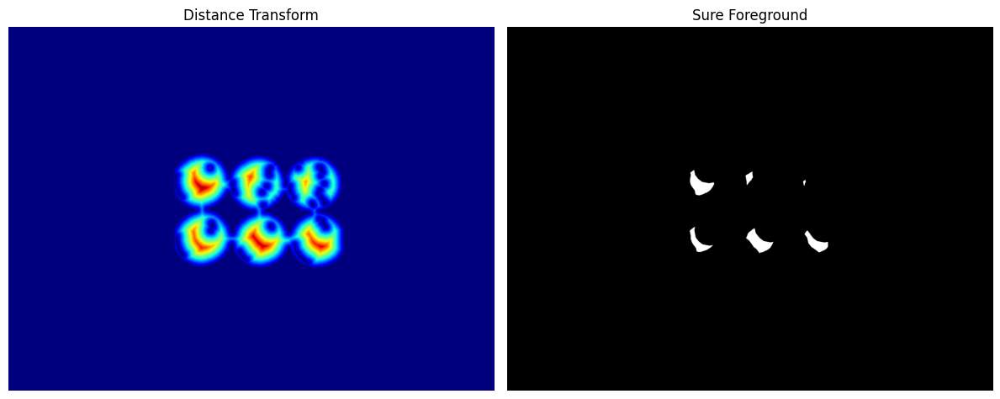

In [51]:
# Apply distance transform
dist_transform = cv.distanceTransform(opening, cv.DIST_L2, 5)

# Normalize for better visualization
dist_normalized = cv.normalize(dist_transform, None, 0, 1.0, cv.NORM_MINMAX)

# Threshold to get sure foreground
ret, sure_fg = cv.threshold(dist_transform, 0.7 * dist_transform.max(), 255, 0)
sure_fg = np.uint8(sure_fg)

# Display the results
display_images([dist_normalized, sure_fg], 
               ['Distance Transform', 'Sure Foreground'], 
               ['jet', 'gray'])

> **Mathematical Foundation**: The distance transform calculates, for each foreground pixel, the distance to the nearest background pixel. The resulting image has higher values the farther a pixel is from the background. 
>
> **When to use distance transform vs. erosion**: Distance transform is preferred when objects are touching because it helps preserve the individual object centers even when they're connected.

## 7. Finding Unknown Region

The unknown region is the area where we're not sure if it's foreground or background. This is typically the boundary between objects.

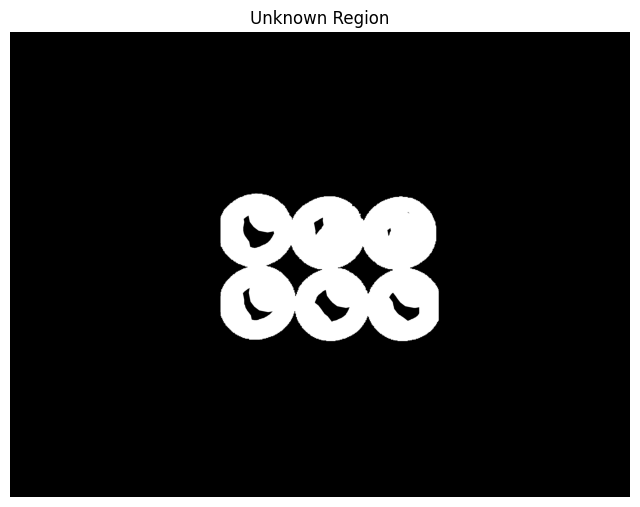

In [52]:
# Find unknown region (not sure if foreground or background)
unknown = cv.subtract(sure_bg, sure_fg)

# Display the unknown region
plt.figure(figsize=(8, 8))
plt.imshow(unknown, cmap='gray')
plt.title('Unknown Region')
plt.axis('off')
plt.show()

> **Intuition Check**: The unknown region (shown in white) represents the boundaries between coins and the transition between coins and background. The watershed algorithm will determine how to divide these regions properly.


## 8. Marker Creation

Now we'll create markers for the watershed algorithm. Each definite foreground region gets a unique label.

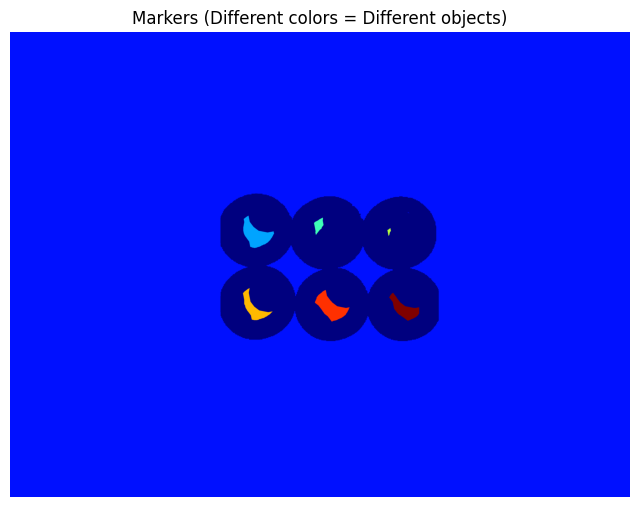

In [53]:
# Label the foreground objects
ret, markers = cv.connectedComponents(sure_fg)

# Add 1 to all labels so that background is not 0, but 1
markers = markers + 1

# Mark the unknown region with 0
markers[unknown == 255] = 0

# Create a colored image to show the markers
markers_display = np.uint8(markers * 25)  # Scale for better visualization

# Display the markers
plt.figure(figsize=(8, 8))
plt.imshow(markers_display, cmap='jet')
plt.title('Markers (Different colors = Different objects)')
plt.axis('off')
plt.show()

> **Understanding the Values**:
> - `markers == 0`: Unknown region (boundary)
> - `markers == 1`: Sure background
> - `markers >= 2`: Different foreground objects (each with a unique label)

Finally, we apply the watershed algorithm to determine how to divide the unknown regions.

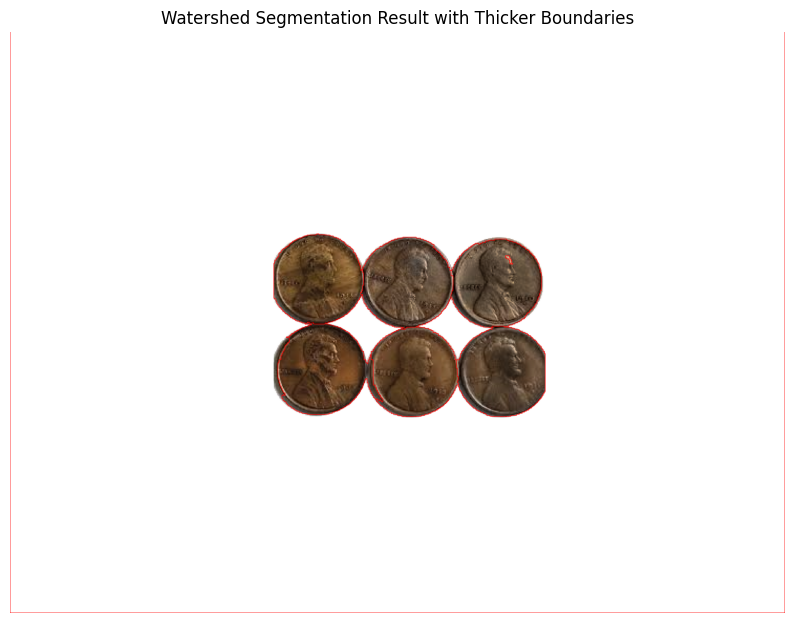

In [56]:

# Apply watershed algorithm (assuming 'img' and 'markers' are already defined)
markers = cv.watershed(img, markers)

# Create a copy of the original image (in RGB)
img_result = img_rgb.copy()

# Create a binary mask where the watershed boundaries are marked (-1)
boundary_mask = (markers == -1).astype(np.uint8) * 255

# Dilate the boundary mask to thicken the boundaries
kernel = np.ones((3, 3), np.uint8)
thick_boundary = cv.dilate(boundary_mask, kernel, iterations=1)

# Mark the thick boundaries in red on the result image
img_result[thick_boundary == 255] = [255, 0, 0]

# Display the final result
plt.figure(figsize=(10, 10))
plt.imshow(img_result)
plt.title('Watershed Segmentation Result with Thicker Boundaries')
plt.axis('off')
plt.show()


> **Important Note**: After watershed processing, boundary pixels are marked with `-1` in the markers array. These are the watershed lines that separate different regions.

## 10. Visualizing Individual Coins

Let's extract and display each segmented coin.

In [57]:
# Create a function to extract individual objects
def extract_objects(image, markers):
    objects = []
    for marker in range(2, markers.max() + 1):  # Skip background (1) and boundaries (-1)
        # Create a mask for this specific object
        mask = np.zeros_like(image[:,:,0], dtype=np.uint8)
        mask[markers == marker] = 255
        
        # Find the bounding box
        x, y, w, h = cv.boundingRect(mask)
        
        # Extract the object using the mask
        masked = cv.bitwise_and(image, image, mask=mask)
        object_img = masked[y:y+h, x:x+w]
        
        # Only add if the object is large enough
        if w > 20 and h > 20:
            objects.append(object_img)
    
    return objects

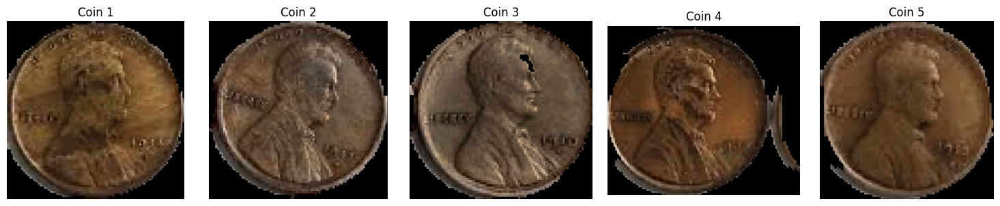

In [58]:
# Extract individual coins
coins = extract_objects(img_rgb, markers)

# Display the first few coins
n_coins = min(len(coins), 5)
plt.figure(figsize=(15, 3))
for i in range(n_coins):
    plt.subplot(1, n_coins, i+1)
    plt.imshow(coins[i])
    plt.title(f'Coin {i+1}')
    plt.axis('off')
plt.tight_layout()
plt.show()

## 11. Reflection and Intuition Check

> **When to use the watershed algorithm?**
>
> Watershed is particularly useful when:
> - Objects are touching or overlapping
> - Objects have relatively uniform intensity
> - You can reliably identify some parts of each object
>
> **Advantages**:
> - Can separate touching objects
> - Works well with proper markers
>
> **Disadvantages**:
> - Sensitive to noise
> - Requires good marker generation
> - Can be computationally intensive for large images

## 12. Exercise: Improve the Segmentation

Try these exercises to deepen your understanding:

1. Adjust the threshold value used for the sure foreground (currently `0.7 * dist_transform.max()`). How does changing this value affect the segmentation?

2. Try different morphological operations or iteration counts. How do they impact the final result?

3. Apply the watershed algorithm to a different image with touching objects.

In [59]:
# Exercise: Try different threshold values for foreground
# Uncomment and modify the code below

# test_threshold = 0.5  # Try values between 0.3 and 0.9
# ret, sure_fg_test = cv.threshold(dist_transform, test_threshold * dist_transform.max(), 255, 0)
# sure_fg_test = np.uint8(sure_fg_test)

# Continue with the rest of the steps...



### Understanding the Watershed Algorithm Steps

1. **Marker-Controlled Watershed**: We started with finding markers to guide the flooding process.
2. **Distance Transform**: Calculates the distance of each foreground pixel to the nearest background pixel.
3. **Sure Foreground/Background**: Identifies regions that definitely belong to objects or background.
4. **Watershed**: Segments the image by treating it as a landscape and "flooding" from the markers.

### Common Pitfalls in Watershed Segmentation

> **Common Pitfall**: Watershed segmentation is notorious for over-segmentation (creating too many regions). Always focus on proper marker selection and noise reduction to avoid this issue. Post-processing techniques like region merging are often necessary to get meaningful results.

1. **Over-segmentation**: The watershed algorithm often produces too many segments.
2. **Marker Selection**: Poor marker selection can lead to incorrect segmentation.
3. **Sensitivity to Noise**: Small noise can create unwanted segments.

### When to Use Watershed Segmentation

Watershed segmentation is particularly effective for:
- Separating touching or overlapping objects
- Segmenting images with clear intensity gradients
- Applications where over-segmentation can be addressed in post-processing


## 6. Object Detection Using Template Matching

Template matching is a technique to find areas of an image that match a template image. It's widely used for locating specific objects in scenes.

### Mathematical Foundation of Template Matching

Template matching is essentially a convolution operation. For an image $I$ and a template $T$, the match result $R$ is given by:

$$R(x,y) = \sum_{x',y'} (T(x',y') \cdot I(x+x', y+y'))$$

Different matching methods use variations of this formula to account for differences in brightness and contrast.

Let's implement template matching:

In [24]:
full_image = cv2.imread('waldo_in_image.png')

# Convert from BGR (OpenCV default) to RGB (for matplotlib)
full_image_rgb = cv2.cvtColor(full_image, cv2.COLOR_BGR2RGB)

gray_image = cv2.cvtColor(full_image, cv2.COLOR_BGR2GRAY)


[ WARN:0@769.373] global grfmt_png.cpp:695 read_chunk chunk data is too large


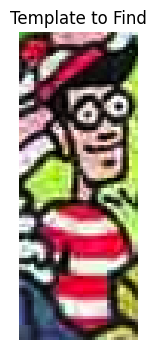

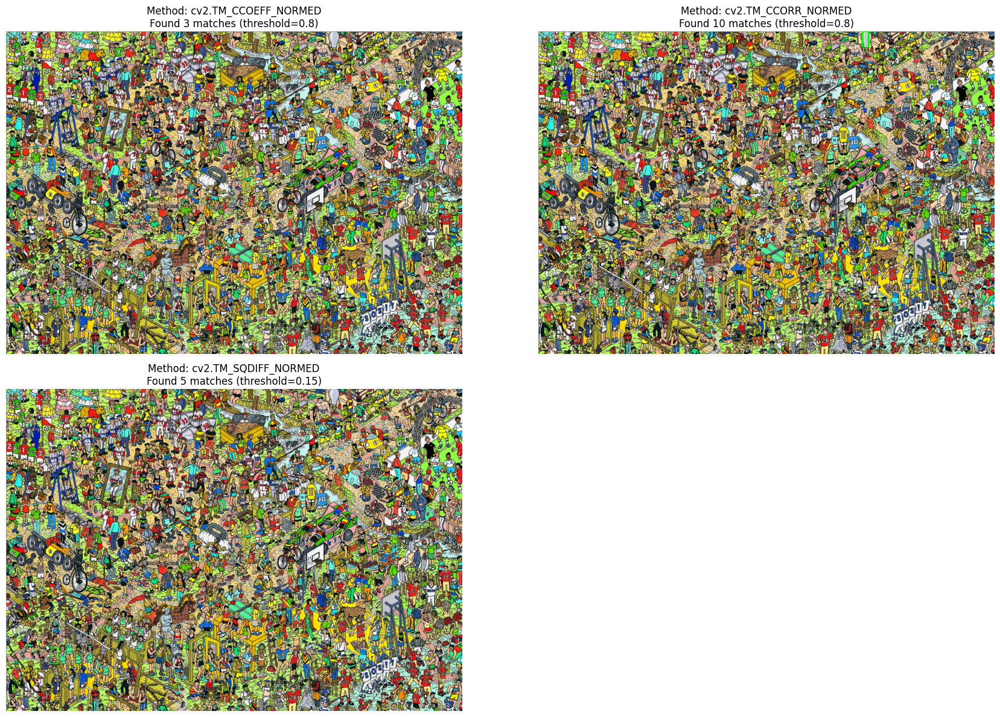

Visualizing template matching with varying thresholds:

Strict matching (fewer false positives, might miss matches):


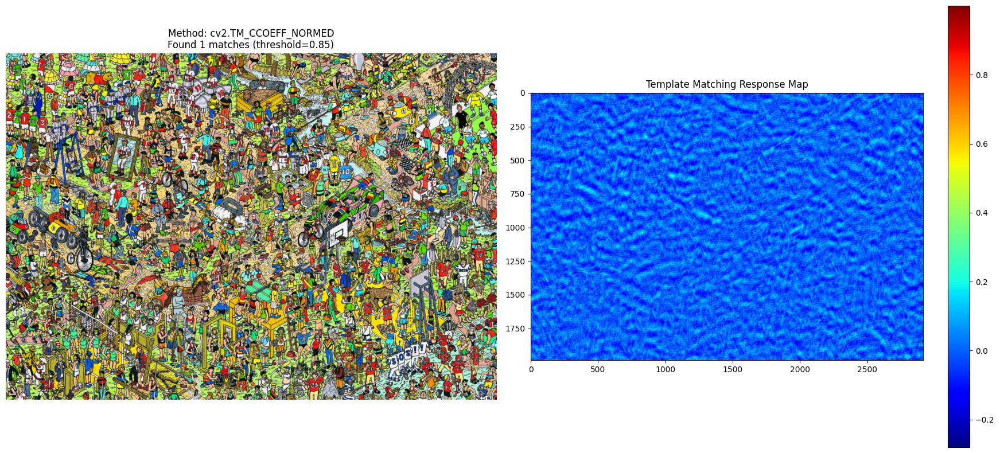


Moderate matching:


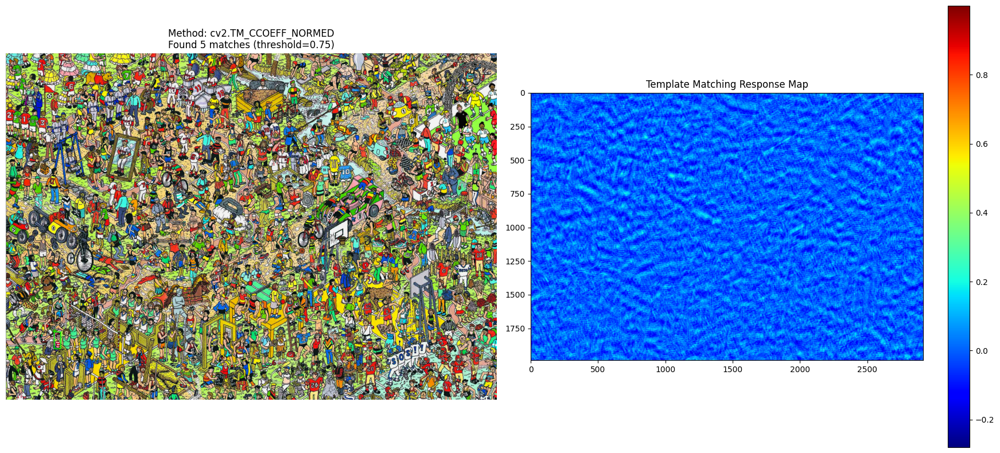


Relaxed matching (more false positives, fewer missed matches):


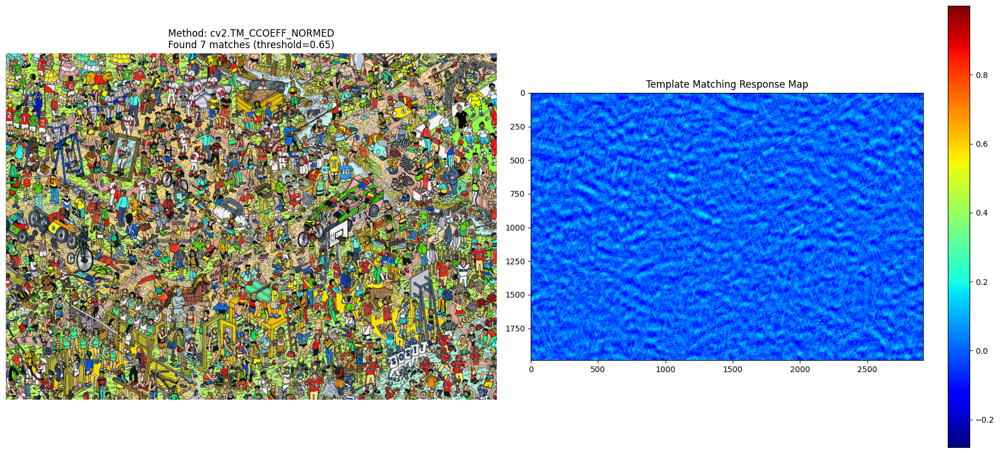

In [25]:
# Load the template image
template = cv2.imread('template.png')
template = cv2.cvtColor(template, cv2.COLOR_BGR2RGB)

# Display the template
plt.figure(figsize=(4, 4))
plt.imshow(template)
plt.title('Template to Find')
plt.axis('off')
plt.show()

# Convert template to grayscale
template_gray = cv2.cvtColor(template, cv2.COLOR_RGB2GRAY)
w, h = template_gray.shape[::-1]

# Apply template matching
methods = [
    ('cv2.TM_CCOEFF_NORMED', cv2.TM_CCOEFF_NORMED),
    ('cv2.TM_CCORR_NORMED', cv2.TM_CCORR_NORMED),
    ('cv2.TM_SQDIFF_NORMED', cv2.TM_SQDIFF_NORMED)
]

plt.figure(figsize=(18, 12))

for idx, (method_name, method) in enumerate(methods):
    # Apply template matching
    res = cv2.matchTemplate(gray_image, template_gray, method)
    
    # Get the match locations
    if method == cv2.TM_SQDIFF_NORMED:
        threshold = 0.15
        loc = np.where(res <= threshold)
    else:
        threshold = 0.8
        loc = np.where(res >= threshold)
    
    # Create a copy of the image to draw results on
    img_display = full_image_rgb.copy()
    
    match_count = 0
    for pt in zip(*loc[::-1]):
        match_count += 1
        cv2.rectangle(img_display, pt, (pt[0] + w, pt[1] + h), (0, 255, 0), 2)
        
        # Only show up to 10 matches to avoid cluttering the image
        if match_count >= 10:
            break
    
    # Display result for this method
    plt.subplot(2, 2, idx+1)
    plt.imshow(img_display)
    plt.title(f'Method: {method_name}\nFound {min(match_count, 10)} matches (threshold={threshold})')
    plt.axis('off')

plt.tight_layout()
plt.show()

# Function to interactively visualize results with different thresholds
def visualize_template_match(method_idx, threshold):
    method_name, method = methods[method_idx]
    
    # Apply template matching
    res = cv2.matchTemplate(gray_image, template_gray, method)
    
    # Create a copy of the image to draw results on
    img_display = full_image_rgb.copy()
    
    # Get match locations based on method type
    if method == cv2.TM_SQDIFF_NORMED:
        loc = np.where(res <= threshold)
    else:
        loc = np.where(res >= threshold)
    
    match_count = 0
    for pt in zip(*loc[::-1]):
        match_count += 1
        cv2.rectangle(img_display, pt, (pt[0] + w, pt[1] + h), (0, 255, 0), 2)
        
        # Only show up to 20 matches to avoid cluttering
        if match_count >= 20:
            break
    
    # Also show the template matching result (correlation map)
    plt.figure(figsize=(18, 8))
    
    plt.subplot(1, 2, 1)
    plt.imshow(img_display)
    plt.title(f'Method: {method_name}\nFound {match_count} matches (threshold={threshold:.2f})')
    plt.axis('off')
    
    plt.subplot(1, 2, 2)
    plt.imshow(res, cmap='jet')
    plt.title('Template Matching Response Map')
    plt.colorbar()
    
    plt.tight_layout()
    plt.show()
    
    return match_count

# Try different threshold values for the best method (usually TM_CCOEFF_NORMED)
print("Visualizing template matching with varying thresholds:")
print("\nStrict matching (fewer false positives, might miss matches):")
matches_strict = visualize_template_match(0, 0.85)

print("\nModerate matching:")
matches_moderate = visualize_template_match(0, 0.75)

print("\nRelaxed matching (more false positives, fewer missed matches):")
matches_relaxed = visualize_template_match(0, 0.65)

In [ ]:
a